[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\tretiak\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\tretiak\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


Without filter extreme 37238
With filter extreme 37234
Topic: 0 
Words: 0.013*"drug" + 0.012*"cell" + 0.009*"protein" + 0.009*"mutation" + 0.007*"inhibitor" + 0.006*"membrane" + 0.005*"mutant" + 0.005*"inhibit" + 0.004*"enzyme" + 0.004*"inhibition" + 0.004*"demonstrate" + 0.004*"peptide" + 0.004*"suggest" + 0.004*"induce" + 0.004*"structure" + 0.004*"site" + 0.004*"virus" + 0.004*"find" + 0.004*"acid" + 0.003*"involve" + 0.003*"cell_wall" + 0.003*"identify" + 0.003*"treatment" + 0.003*"bind" + 0.003*"reduce" + 0.003*"reveal" + 0.003*"confer" + 0.003*"interaction" + 0.003*"assay" + 0.003*"decrease"


Topic: 1 
Words: 0.018*"drug" + 0.016*"infection" + 0.012*"bacteria" + 0.010*"pathogen" + 0.010*"treatment" + 0.007*"include" + 0.007*"use" + 0.005*"agent" + 0.005*"therapy" + 0.005*"environment" + 0.005*"develop" + 0.004*"host" + 0.004*"biofilm" + 0.004*"review" + 0.004*"cause" + 0.004*"identify" + 0.004*"disease" + 0.004*"population" + 0.004*"virulence" + 0.004*"provide" + 0.003*"base" + 

c:\Users\tretiak\Anaconda3\Anaconda3.0\lib\site-packages\past\builtins\misc.py:45: DeprecationWarning: the imp module is deprecated in favour of importlib; see the module's documentation for alternative uses
  from imp import reload


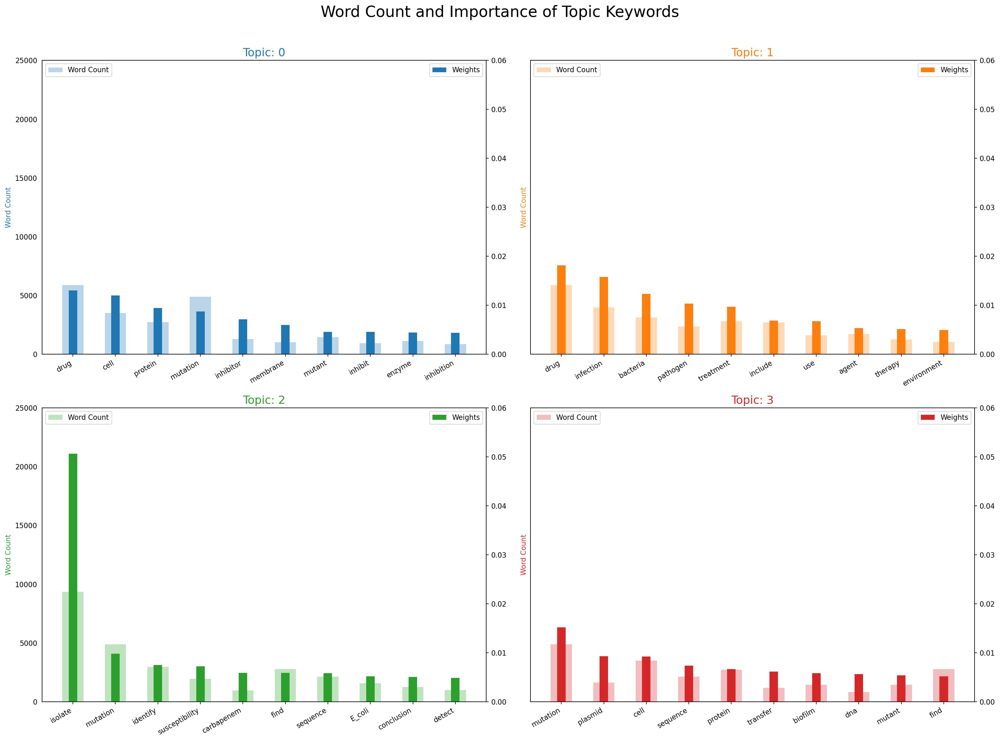

In [2]:
import warnings
warnings.filterwarnings("ignore")
import pandas as pd
from textblob import TextBlob
def pos_tag(text):
    try:
        return TextBlob(text).tags
    except:
        return None
def get_adjectives(text):    
    blob = TextBlob(text)
    return [ word for (word,tag) in blob.tags if (tag == "NN" or tag == "NNS" or tag == "NNP" or tag == "NNPS" or tag == "RB" or tag == "RBR" or tag == "RBS" or tag == "RP" or tag == "VB" or tag == "VBD" or tag == "VBG" or tag == "VBN" or tag == "VBP" or tag == "VBZ" or tag == "FW" )]
import matplotlib.pyplot as plt

from socket import SocketIO
import pandas as pd
import numpy as np

review_datasets = pd.read_excel(r'C:\Users\tretiak\Desktop\Topic_modeling\Articles_with_topics_6.0.xlsx')
reviews_datasets1 = pd.DataFrame(review_datasets, columns=['Articles'])
reviews_datasets2=reviews_datasets1.iloc [0:8000]
reviews_datasets4 = pd.DataFrame(review_datasets, columns=['Articles'])
reviews_datasets=reviews_datasets2[~reviews_datasets1.Articles.str.contains('None')]
reviews_datasets.head()
import nltk
nltk.download('stopwords')
nltk.download('punkt')
from nltk.stem import WordNetLemmatizer
from nltk.corpus import stopwords
from sklearn.feature_extraction.text import TfidfVectorizer
from nltk.tokenize import word_tokenize
import string
import gensim
from gensim.utils import simple_preprocess
from gensim import corpora
import gensim.corpora as corpora
from nltk.stem import WordNetLemmatizer
from nltk.stem import porter
import spacy
nlp = spacy.load('en_core_web_sm')
stop_words = spacy.lang.en.stop_words.STOP_WORDS
new_stopwords = ["Background", "Main body", "Conclusion", "Methodology", "Methods", "Results", "Conclusions", "also", "Aim","Materials", "Aims", "Objective", "Design", "Interpretation", "Objectives", "Context"]
new_stopwords.extend(['study',"bla",'activity','found','two','different','identified','expression','including','clinical','showed','patient','associated','one','result','using','may','increased','presence','used','effect','among','development','level','new','analysis','observed','target','novel','However','potential','concentration','system','role','specie','method','compound','important','respectively','well','increase','due','three','high','detected','show','combination','revealed','change','rate','involved','type','common','model','addition','several','growth','data','present','within','multiple','major','class','known','tested','demonstrated','group','compared','region','factor','complex','response','determined','production','effective','strategy','control','investigated','approach','specific','reduced','various','function','many','responsible', 'ability','four','significant','similar','related','variant','profile','case','total','pathway','sensitive','studied','report','selection','performed','suggesting','higher','understanding','shown','first','substitution','active','via','selected','increasing','caused','reported','number','test','element','finding','time','highly' ])

#print(new_stopwords)
exclude = set(string.punctuation)

def bigrams(words, bi_min=15, tri_min=10):
    bigram = gensim.models.Phrases(words, min_count = bi_min)
    bigram_mod = gensim.models.phrases.Phraser(bigram)
    return bigram_mod

def alphabet(ch):
    return ch.replace("α","alpha").replace("MICs","MIC").replace("β","beta").replace("γ","gamma").replace("δ","delta").replace("ε","epsilon").replace("ζ","zeta").replace("η","eta").replace("θ","theta").replace("ι","iota").replace("κ","kappa").replace("λ","lambda").replace("μ","mu").replace("ν","nu").replace("ξ","xi").replace("ο","omicron").replace("π","pi").replace("ρ","rho").replace("σ","sigma").replace("τ","tau").replace("υ","upsilon").replace("φ","phi").replace("χ","chi").replace("ψ","psi").replace("ω","omega")

def clean_text(headline):
    doc = nlp(headline)
    lemmatized_tokens = [token.lemma_ for token in doc if not token.is_stop and not token.is_digit and len(token) > 1]
    cleaned_text1 = " ".join(alphabet(ch) for ch in lemmatized_tokens if ch not in exclude)
    cleaned_text2 = " ".join(ch for ch in cleaned_text1.split("."))
    #new_stopwords1 = " ".join(i.lemma_ for i in nlp(new_stopwords)) 
    cleaned_text=" ".join(ch for ch in cleaned_text2.split() if ch not in new_stopwords)
    return cleaned_text
reviews_datasets['cleaned_text']=reviews_datasets['Articles'].apply(clean_text)
reviews_datasets['words'] = reviews_datasets['cleaned_text'].apply(get_adjectives)
#doc_clean1 = " ".join([clean_text(doc).split() for doc in reviews_datasets['Articles']] )
#doc_clean = [clean_text(doc).split() for doc in doc_clean1]   
#doc_clean1 = [clean_text(doc).split() for doc in reviews_datasets['Articles']] 
#doc_clean = [doc for doc in reviews_datasets['Articles']]  
doc_clean=[]
for doc in reviews_datasets['cleaned_text']:
    doc_clean.append(get_adjectives(doc))
    #doc_clean.append(doc_clean1)
   

bigram_mod = bigrams(doc_clean)
bigram = [bigram_mod[review] for review in doc_clean ]
#bigram=[get_adjectives(words) for words in bigram1]
#creating LDA model
id2word = corpora.Dictionary(bigram)
print("Without filter extreme",len(id2word))
id2word.filter_extremes(no_below=1, no_above=0.4)
print("With filter extreme",len(id2word))
corpus = [id2word.doc2bow(text) for text in bigram]

#creating LDA model
Lda = gensim.models.ldamodel.LdaModel
from gensim.test.utils import datapath
# Create the LDA model and fit it to the training data
ldamodel = Lda(corpus=corpus , id2word=id2word, passes=10, iterations=10, random_state=42, num_topics=4, decay=0.5, offset=1, alpha="auto", eta="auto")
ldamodel.save('lda_train.model')
#printing topics
for idx, topic in ldamodel.print_topics(-1,num_words=30 ):
    print("Topic: {} \nWords: {}".format(idx, topic))
    print("\n")


from sklearn.metrics import confusion_matrix
print("==================================================")
# Use the LDA model to make predictions on the test data
#predictions = ldamodel[corpusTest]
#ldamodel.update(corpusTest)
#print("predictions ", predictions)
for idx, topic in ldamodel.print_topics(-1,num_words=30 ):
    print("Topic: {} \nWords: {}".format(idx, topic))
    print("\n")

# Create the confusion matrix
#cm = confusion_matrix(y_test, predictions)
# get the model's topics in their native ordering...
all_topics = ldamodel.print_topics(num_words=30)
# create an empty list per topic to collect the docs:
docs_per_topic = [[] for _ in all_topics]
# create an empty list per document to collect the topics:
topics_per_document=[[] for i in corpus ]
# create an empty list for collecting dominant topics for documents:
topic_out=[]
weight_out=[]


zero=0
first=0
second=0
third=0
fourth=0
# for every doc...
for doc_id, doc_bow in enumerate(corpus ):
    # get its topics
    doc_topics = ldamodel.get_document_topics(doc_bow)
    # and  for each of its topics
    for topic_id, score in doc_topics:
        # add the topic_id & its score to the each document list
         topics_per_document[doc_id].append((topic_id, score))
         docs_per_topic[topic_id].append((doc_id, score))
for i in topics_per_document:
    #sort topics by their score
    main_topic=sorted(list(i),key=lambda x: x[1], reverse=True)
    #add the dominant one
    topic_out.append(main_topic[0][0])
    weight_out.append(main_topic[0][1])
    if(main_topic[0][0]==0 and main_topic[0][1]>=0.5):
        zero+=1
    if(main_topic[0][0]==1 and main_topic[0][1]>=0.5):
        first+=1
    if(main_topic[0][0]==2 and main_topic[0][1]>=0.5):
        second+=1
    if(main_topic[0][0]==3 and main_topic[0][1]>=0.5):
        third+=1 
    if(main_topic[0][0]==4 and main_topic[0][1]>=0.5):
       fourth+=1




reviews_datasets['Topic'] = topic_out
reviews_datasets['Topic weight'] = weight_out
reviews_datasets['colFromIndex'] = reviews_datasets.index

#reviews_datasets=reviews_datasets.dropna()
writer = pd.ExcelWriter('CompareTopics.0.xlsx')
reviews_datasets.sort_values( by =['Topic','colFromIndex']).to_excel(writer)
writer.save()


topic_zero = reviews_datasets[reviews_datasets['Topic'] == 0]
print('Number of documents with zero topic: ', len(topic_zero))
#topic_zero2=0
#for i in review_datasets:
#if ((review_datasets['Topic'] == 0) and (review_datasets['Topic weight'] >= 0.5)):
   # topic_zero2+=1 
topic_zero1=reviews_datasets['Topic weight'] .where(reviews_datasets['Topic'] == 0)
#topic_zero2=topic_zero1.where(review_datasets['Topic weight'] >= 0.5)
print('Number of documents with zero topic above 0.5: ', zero)
#print(topic_zero1)

topic_first = reviews_datasets[reviews_datasets['Topic'] == 1]
print('Number of documents with first topic: ', len(topic_first))
print('Number of documents with first topic above 0.5: ', first)

topic_second = reviews_datasets[reviews_datasets['Topic'] == 2]
print('Number of documents with second topic: ', len(topic_second))
print('Number of documents with second topic above 0.5: ', second)

topic_third = reviews_datasets[reviews_datasets['Topic'] == 3]
print('Number of documents with third topic: ', len(topic_third))
print('Number of documents with third topic above 0.5: ', third)

topic_fourth = reviews_datasets[reviews_datasets['Topic'] == 4]
print('Number of documents with fourth topic: ', len(topic_fourth))
print('Number of documents with fourth topic above 0.5: ', fourth)
# Compute Perplexity Score
print('nPerplexity Score: ', ldamodel.log_perplexity(corpus))

# Compute Coherence Score
coherence_model_lda = gensim.models.CoherenceModel(model=ldamodel, texts=bigram, dictionary=id2word, coherence='c_v')
coherence_lda = coherence_model_lda.get_coherence()
print('nCoherence Score: ', coherence_lda)


print("Alpha score: ", ldamodel.alpha)
print("Eta score: ", ldamodel.eta)

# Plotting tools
import pyLDAvis
import pyLDAvis.gensim_models  # don't skip this
import matplotlib.pyplot as plt
%matplotlib inline

pyLDAvis.enable_notebook()
vis = pyLDAvis.gensim_models.prepare(ldamodel, corpus, id2word)
vis

from collections import Counter
import matplotlib.colors as mcolors
topics = ldamodel.show_topics(formatted=False)
data_flat = [w for w_list in bigram for w in w_list]
counter = Counter(data_flat)

out = []
for i, topic in topics:
    for word, weight in topic:
        out.append([word, i , weight, counter[word]])

df = pd.DataFrame(out, columns=['word', 'topic_id', 'importance', 'word_count'])        
writer = pd.ExcelWriter('WordsCount.xlsx')
df.to_excel(writer)
writer.save()

# Plot Word Count and Weights of Topic Keywords
fig, axes = plt.subplots(2, 2, figsize=(20,14), sharey=True, dpi=160)
#axes[1][2].set_visible(False)
cols = [color for name, color in mcolors.TABLEAU_COLORS.items()]
for i, ax in enumerate(axes.flatten()):
    ax.bar(x='word', height="word_count", data=df.loc[df.topic_id==i, :], color=cols[i], width=0.5, alpha=0.3, label='Word Count')
    ax_twin = ax.twinx()
    ax_twin.bar(x='word', height="importance", data=df.loc[df.topic_id==i, :], color=cols[i], width=0.2, label='Weights')
    ax.set_ylabel('Word Count', color=cols[i])
    ax_twin.set_ylim(0, 0.06); ax.set_ylim(0, 25000)
    ax.set_title('Topic: ' + str(i), color=cols[i], fontsize=16)
    ax.tick_params(axis='y', left=False)
    ax.set_xticklabels(df.loc[df.topic_id==i, 'word'], rotation=30, horizontalalignment= 'right')
    ax.legend(loc='upper left'); ax_twin.legend(loc='upper right')

fig.tight_layout(w_pad=2)    
fig.suptitle('Word Count and Importance of Topic Keywords', fontsize=22, y=1.05)    
plt.show()

In [50]:
review_lemmatized = reviews_datasets['cleaned_text'] .tolist()

from top2vec import Top2Vec
model = Top2Vec(documents=review_lemmatized, speed="learn", workers=8)

2023-03-22 12:48:32,101 - top2vec - INFO - Pre-processing documents for training
2023-03-22 12:48:36,500 - top2vec - INFO - Creating joint document/word embedding
2023-03-22 12:49:08,875 - top2vec - INFO - Creating lower dimension embedding of documents
2023-03-22 12:49:15,747 - top2vec - INFO - Finding dense areas of documents
2023-03-22 12:49:16,046 - top2vec - INFO - Finding topics


In [19]:
model.get_num_topics()

90

In [20]:
# Get the topic sizes
topic_sizes = model.get_topic_sizes()

# Print the topic sizes
for topic_id, size in enumerate(topic_sizes):
    print(f"Topic {topic_id}: {size} documents")

Topic 0: [521 251 198 196 191 182 169 167 161 156 154 144 129 128 128 127 126 124
 114 113 111 109 108 104  97  96  95  94  91  89  88  88  88  86  86  85
  84  80  80  79  79  77  77  76  76  75  74  73  72  70  69  68  65  65
  64  61  56  55  54  54  53  52  51  50  49  47  47  46  45  45  44  44
  44  42  42  38  38  38  36  36  33  32  31  29  27  27  26  25  25  18] documents
Topic 1: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71
 72 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89] documents


In [28]:

total = sum(numbers)
numbers = [484, 298, 231, 221, 212, 199, 176, 173, 162, 160, 156, 148, 146, 141, 134, 132, 127, 126, 123, 119, 115, 113, 109, 106, 103, 101, 101, 98, 95, 91, 91, 91, 90, 89, 88, 87, 85, 84, 84, 83, 82, 81, 79, 78, 78, 77, 70, 70, 69, 69, 68, 63, 60, 60, 59, 56, 55, 55, 54, 52, 50, 49, 46, 45, 45, 42, 42, 41, 41, 40, 40, 40, 40, 38, 38, 38, 38, 35, 35, 34, 31, 31, 29, 22]

print(f"The sum of the numbers is {total}.")

The sum of the numbers is 7837.


In [6]:
t=[[16, 34, 2, 84, 50, 33, 39, 74, 10, 55, 57, 6, 68, 64, 19, 53, 69, 35, 30, 11, 22, 12, 54, 17, 5, 83, 29, 87, 71, 59, 4],[75, 45, 31, 56, 70, 89, 9, 82, 8, 28, 46, 47, 85, 32, 86, 13, 48, 52, 36, 23, 26, 88, 1],[44, 63, 18, 15, 25, 0],[67, 79, 40, 72, 20, 81, 14, 62, 27, 38, 80, 7],[76, 21, 42, 3, 51, 73, 65, 77, 43, 61, 60, 24, 78, 37, 66, 58, 49, 41]]
numbers = [521, 251, 198, 196, 191, 182, 169, 167, 161, 156, 154, 144, 129, 128, 128, 127, 126, 124,
114, 113, 111, 109, 108, 104, 97, 96, 95, 94, 91, 89, 88, 88, 88, 86, 86, 85,
84, 80, 80, 79, 79, 77, 77, 76, 76, 75, 74, 73, 72, 70, 69, 68, 65, 65,
64, 61, 56, 55, 54, 54, 53, 52, 51, 50, 49, 47, 47, 46, 45, 45, 44, 44,
44, 42, 42, 38, 38, 38, 36, 36, 33, 32, 31, 29, 27, 27, 26, 25, 25, 18]
print(len(numbers))
for i in t:
    sum=0
    for k in i:
        print(k)
        sum+=numbers[k]
    print(sum)
 

84
16
34
2
84


IndexError: list index out of range

In [5]:
model.topic_words

array([['review', 'discuss', 'current', ..., 'pharmaceutical', 'way',
        'traditional'],
       ['peptide', 'cationic', 'amp', ..., 'pore', 'nanoparticle',
        'lytic'],
       ['carbapenem', 'carbapenemase', 'oxa', ..., 'vitek', 'taiwan',
        'intensive'],
       ...,
       ['cm', 'tc', 'transmissible', ..., 'equally', 'metabolite',
        'transformant'],
       ['crispr', 'cas', 'bacteriophage', ..., 'application', 'microbe',
        'loci'],
       ['mycoplasma', 'homini', 'agalactiae', ..., 'linezolid', 'mls',
        'sequence']], dtype='<U15')

c:\Users\tretiak\Anaconda3\Anaconda3.0\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
c:\Users\tretiak\Anaconda3\Anaconda3.0\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
c:\Users\tretiak\Anaconda3\Anaconda3.0\lib\site-packages\wordcloud\wordcloud.py:519: DeprecationWarning: ROTATE_90 is deprecated and will be removed in Pillow 10 (2023-07-01). Use Transpose.ROTATE_90 instead.
  orientation = (Image.ROTATE_90 if orientation is None else
c:\Users\tretiak\Anaconda3\Anaconda3.0\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlen

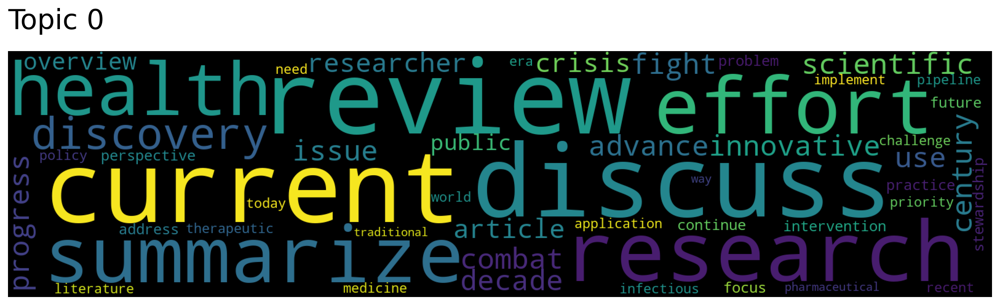

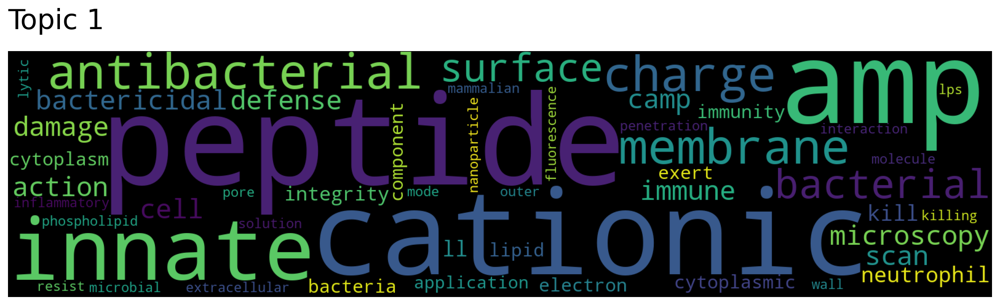

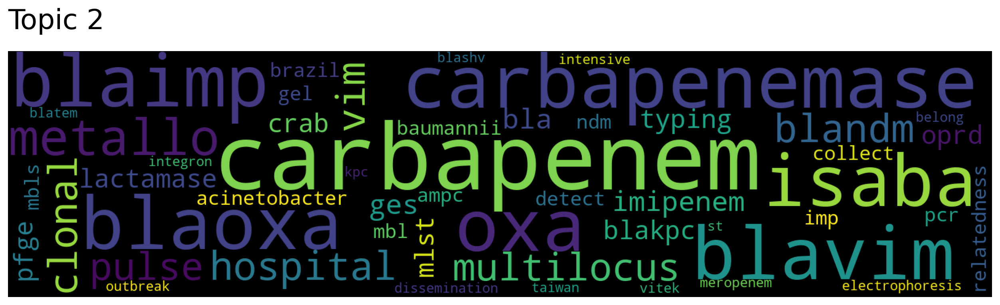

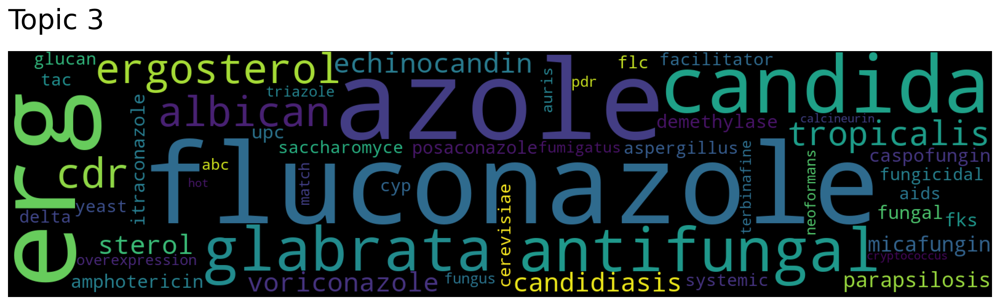

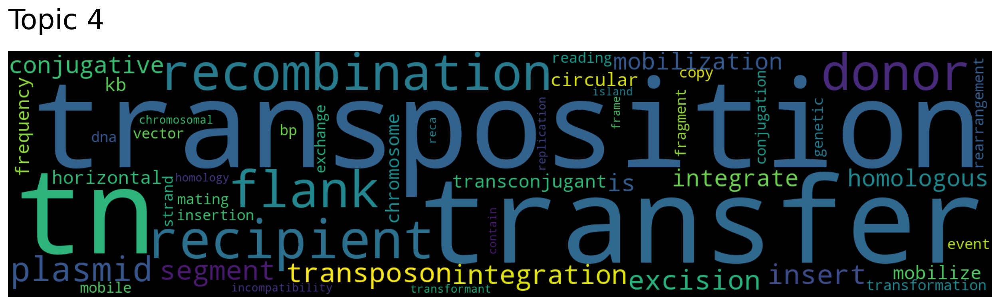

...

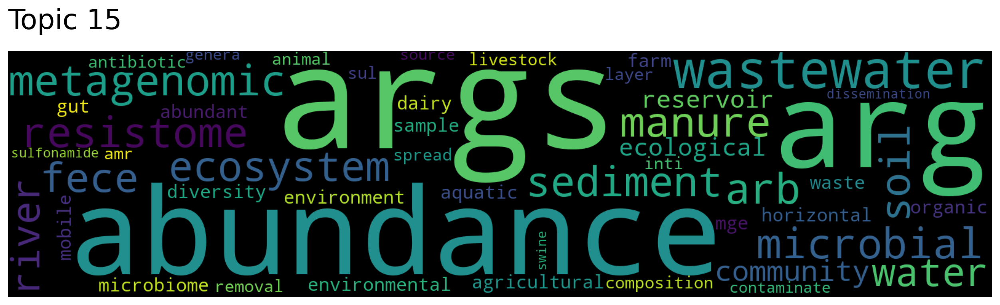

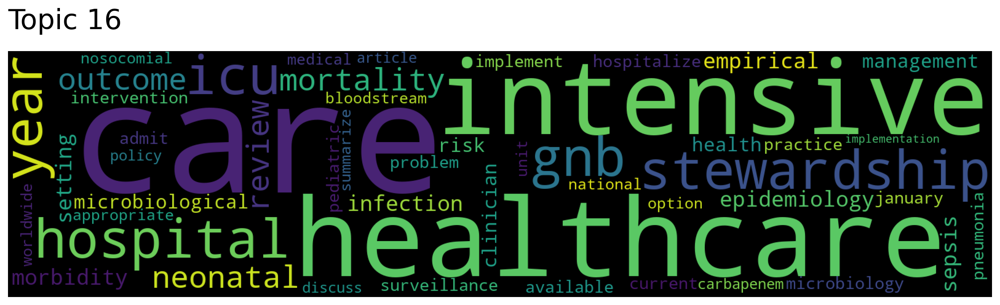

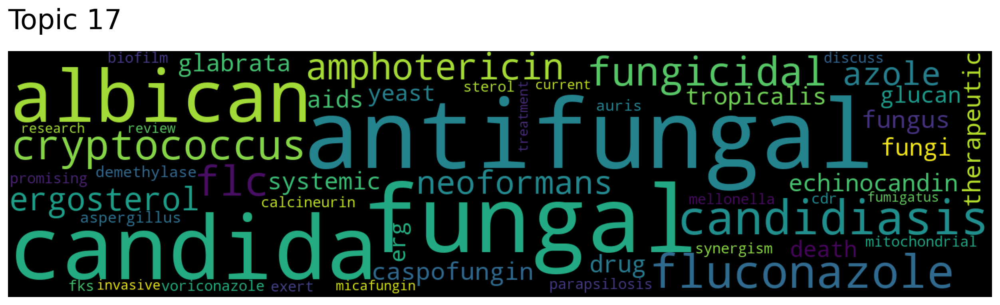

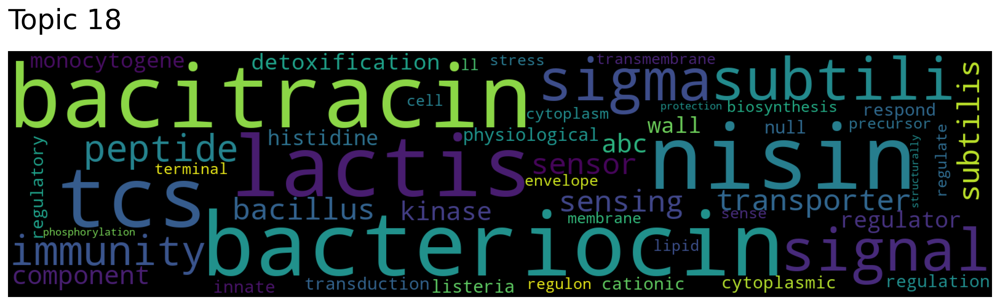

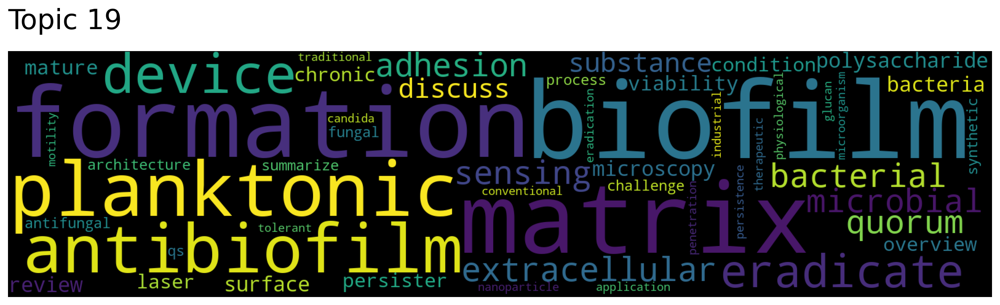

In [6]:
for i in range(20):
    model.generate_topic_wordcloud(i)

In [36]:
model.hierarchical_topic_reduction(num_topics=5)

[[16,
  34,
  2,
  84,
  50,
  33,
  39,
  74,
  10,
  55,
  57,
  6,
  68,
  64,
  19,
  53,
  69,
  35,
  30,
  11,
  22,
  12,
  54,
  17,
  5,
  83,
  29,
  87,
  71,
  59,
  4],
 [75,
  45,
  31,
  56,
  70,
  89,
  9,
  82,
  8,
  28,
  46,
  47,
  85,
  32,
  86,
  13,
  48,
  52,
  36,
  23,
  26,
  88,
  1],
 [44, 63, 18, 15, 25, 0],
 [67, 79, 40, 72, 20, 81, 14, 62, 27, 38, 80, 7],
 [76, 21, 42, 3, 51, 73, 65, 77, 43, 61, 60, 24, 78, 37, 66, 58, 49, 41]]

In [40]:
topic_mapping = model.hierarchical_topic_reduction(num_topics=5)
model.topic_words_reduced

array([['bacterial', 'physiological', 'biofilm', 'membrane', 'bacteria',
        'persister', 'antibiotic', 'cationic', 'peptide', 'planktonic',
        'microbial', 'cell', 'lipid', 'stress', 'physiology',
        'stationary', 'tolerance', 'cytoplasmic', 'charge', 'density',
        'survive', 'survival', 'damage', 'microbe', 'cellular', 'oxygen',
        'sense', 'process', 'outer', 'nutrient', 'wall', 'motive',
        'kill', 'cytoplasm', 'way', 'viability', 'condition', 'adaptive',
        'microscopy', 'exponential', 'force', 'quorum', 'intracellular',
        'integrity', 'molecule', 'sensing', 'innate', 'tolerant',
        'peptidoglycan', 'evolution'],
       ['clonal', 'collect', 'detect', 'esbl', 'pfge', 'isolate',
        'carry', 'carbapenemase', 'multilocus', 'ctx', 'lactamase',
        'pulse', 'oxa', 'typing', 'blaoxa', 'parc', 'mlst', 'qnrs',
        'hospital', 'carbapenem', 'surveillance', 'st', 'quinolone',
        'blakpc', 'prevalence', 'disk', 'aada', 'extend',


c:\Users\tretiak\Anaconda3\Anaconda3.0\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
c:\Users\tretiak\Anaconda3\Anaconda3.0\lib\site-packages\wordcloud\wordcloud.py:519: DeprecationWarning: ROTATE_90 is deprecated and will be removed in Pillow 10 (2023-07-01). Use Transpose.ROTATE_90 instead.
  orientation = (Image.ROTATE_90 if orientation is None else
c:\Users\tretiak\Anaconda3\Anaconda3.0\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
c:\Users\tretiak\Anaconda3\Anaconda3.0\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlen

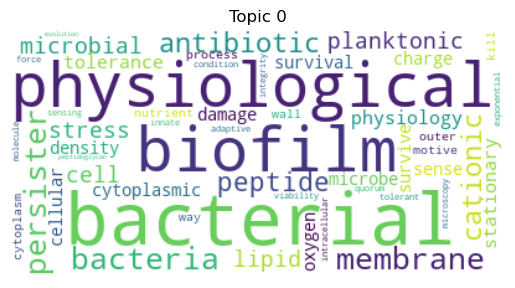

c:\Users\tretiak\Anaconda3\Anaconda3.0\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
c:\Users\tretiak\Anaconda3\Anaconda3.0\lib\site-packages\wordcloud\wordcloud.py:519: DeprecationWarning: ROTATE_90 is deprecated and will be removed in Pillow 10 (2023-07-01). Use Transpose.ROTATE_90 instead.
  orientation = (Image.ROTATE_90 if orientation is None else
c:\Users\tretiak\Anaconda3\Anaconda3.0\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
c:\Users\tretiak\Anaconda3\Anaconda3.0\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlen

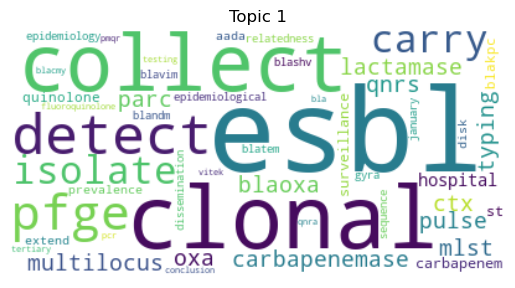

c:\Users\tretiak\Anaconda3\Anaconda3.0\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
c:\Users\tretiak\Anaconda3\Anaconda3.0\lib\site-packages\wordcloud\wordcloud.py:519: DeprecationWarning: ROTATE_90 is deprecated and will be removed in Pillow 10 (2023-07-01). Use Transpose.ROTATE_90 instead.
  orientation = (Image.ROTATE_90 if orientation is None else
c:\Users\tretiak\Anaconda3\Anaconda3.0\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
c:\Users\tretiak\Anaconda3\Anaconda3.0\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlen

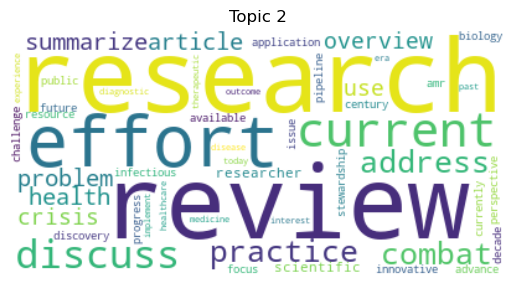

c:\Users\tretiak\Anaconda3\Anaconda3.0\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
c:\Users\tretiak\Anaconda3\Anaconda3.0\lib\site-packages\wordcloud\wordcloud.py:519: DeprecationWarning: ROTATE_90 is deprecated and will be removed in Pillow 10 (2023-07-01). Use Transpose.ROTATE_90 instead.
  orientation = (Image.ROTATE_90 if orientation is None else
c:\Users\tretiak\Anaconda3\Anaconda3.0\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
c:\Users\tretiak\Anaconda3\Anaconda3.0\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlen

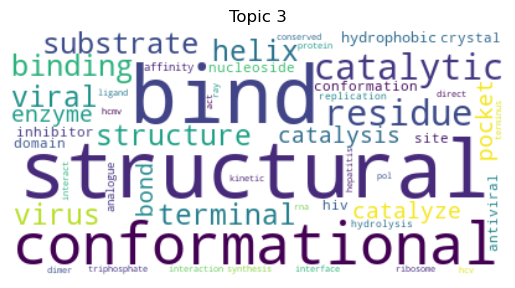

c:\Users\tretiak\Anaconda3\Anaconda3.0\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
c:\Users\tretiak\Anaconda3\Anaconda3.0\lib\site-packages\wordcloud\wordcloud.py:519: DeprecationWarning: ROTATE_90 is deprecated and will be removed in Pillow 10 (2023-07-01). Use Transpose.ROTATE_90 instead.
  orientation = (Image.ROTATE_90 if orientation is None else
c:\Users\tretiak\Anaconda3\Anaconda3.0\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
c:\Users\tretiak\Anaconda3\Anaconda3.0\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlen

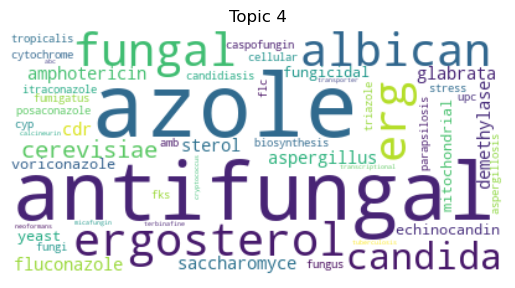

In [43]:
from wordcloud import WordCloud
for i, topic in enumerate(model.topic_words_reduced):
    plt.figure()
    plt.title(f"Topic {i}")
    wordcloud = WordCloud(background_color='white').generate(' '.join(topic))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.show()

In [48]:

topic_size = model.get_topic_sizes()
print(f"Number of documents assigned to Topic {i}: {topic_size}")

AttributeError: 'Top2Vec' object has no attribute 'get_topic_sizes_reduced'

In [34]:
model.get_num_topics()

90

In [26]:
print(topic_mapping)

[[16, 34, 2, 84, 50, 33, 39, 74, 10, 55, 57, 6, 68, 64, 19, 53, 69, 35, 30, 11, 22, 12, 54, 17, 5, 83, 29, 87, 71, 59, 4], [75, 45, 31, 56, 70, 89, 9, 82, 8, 28, 46, 47, 85, 32, 86, 13, 48, 52, 36, 23, 26, 88, 1], [44, 63, 18, 15, 25, 0], [67, 79, 40, 72, 20, 81, 14, 62, 27, 38, 80, 7], [76, 21, 42, 3, 51, 73, 65, 77, 43, 61, 60, 24, 78, 37, 66, 58, 49, 41]]


c:\Users\tretiak\Anaconda3\Anaconda3.0\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
c:\Users\tretiak\Anaconda3\Anaconda3.0\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
c:\Users\tretiak\Anaconda3\Anaconda3.0\lib\site-packages\wordcloud\wordcloud.py:519: DeprecationWarning: ROTATE_90 is deprecated and will be removed in Pillow 10 (2023-07-01). Use Transpose.ROTATE_90 instead.
  orientation = (Image.ROTATE_90 if orientation is None else
c:\Users\tretiak\Anaconda3\Anaconda3.0\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlen

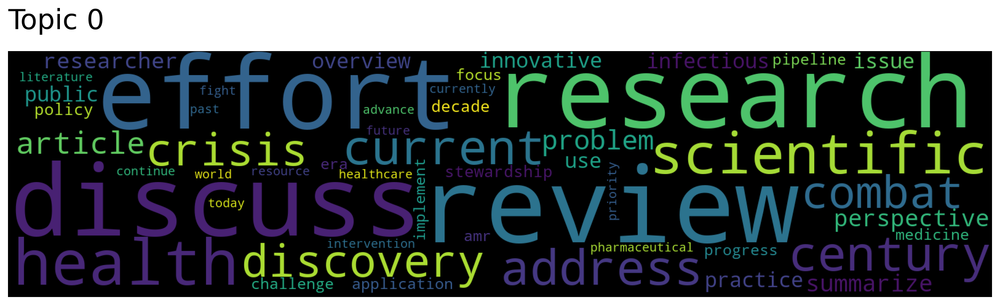

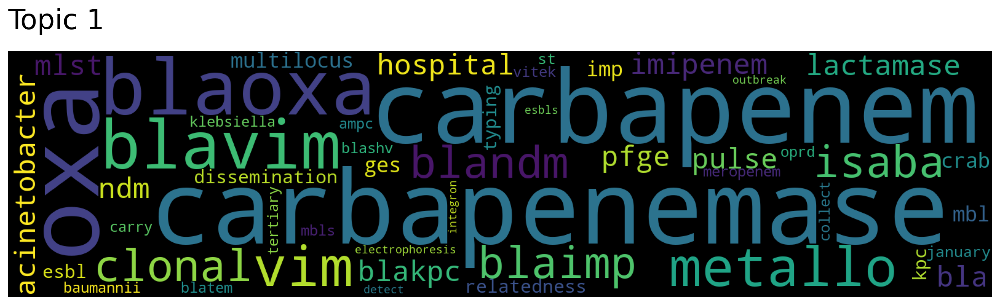

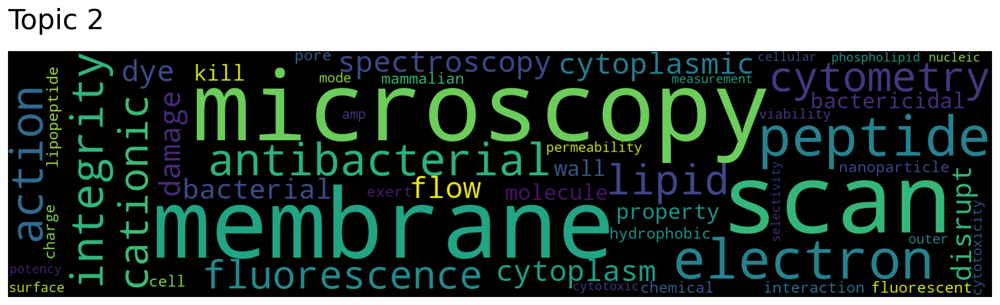

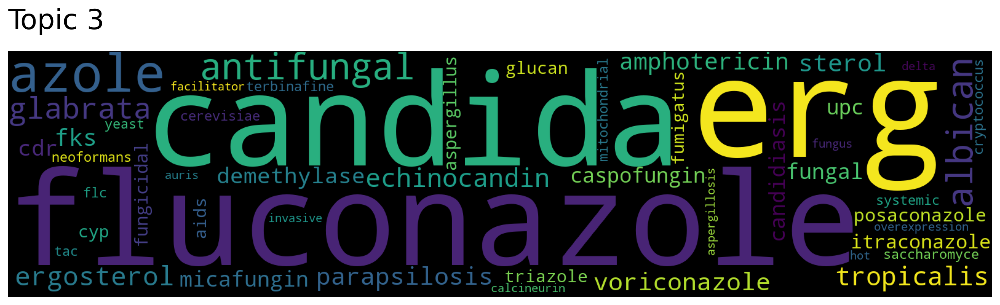

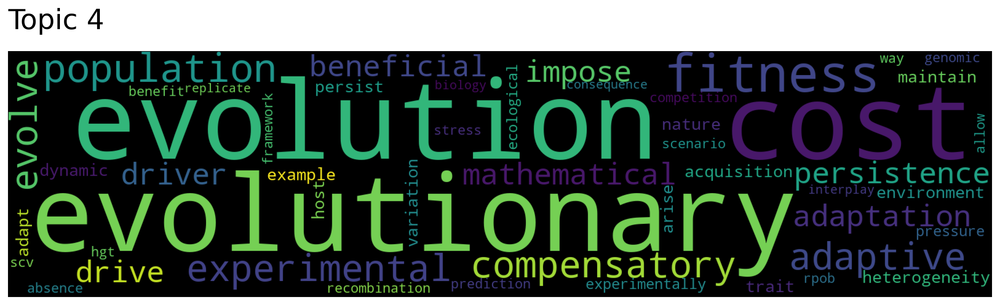

In [25]:
for i in range(5):
    model.generate_topic_wordcloud(i)

In [9]:
model.get_topic_sizes()

(array([484, 298, 231, 221, 212, 199, 176, 173, 162, 160, 156, 148, 146,
        141, 134, 132, 127, 126, 123, 119, 115, 113, 109, 106, 103, 101,
        101,  98,  95,  91,  91,  91,  90,  89,  88,  87,  85,  84,  84,
         83,  82,  81,  79,  78,  78,  77,  70,  70,  69,  69,  68,  63,
         60,  60,  59,  56,  55,  55,  54,  52,  50,  49,  46,  45,  45,
         42,  42,  41,  41,  40,  40,  40,  40,  38,  38,  38,  38,  35,
         35,  34,  31,  31,  29,  22], dtype=int64),
 array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
        51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67,
        68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83],
       dtype=int64))

In [16]:
# Get the topic sizes
topic_sizes = model.get_topic_sizes()

# Print the topic sizes
for topic_id, size in enumerate(topic_sizes):
    print(f"Topic {topic_id}: {size} documents")

Topic 0: [484 298 231 221 212 199 176 173 162 160 156 148 146 141 134 132 127 126
 123 119 115 113 109 106 103 101 101  98  95  91  91  91  90  89  88  87
  85  84  84  83  82  81  79  78  78  77  70  70  69  69  68  63  60  60
  59  56  55  55  54  52  50  49  46  45  45  42  42  41  41  40  40  40
  40  38  38  38  38  35  35  34  31  31  29  22] documents
Topic 1: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71
 72 73 74 75 76 77 78 79 80 81 82 83] documents


In [29]:
numbers = [484, 298, 231, 221, 212, 199, 176, 173, 162, 160, 156, 148, 146, 141, 134, 132, 127, 126, 123, 119, 115, 113, 109, 106, 103, 101, 101, 98, 95, 91, 91, 91, 90, 89, 88, 87, 85, 84, 84, 83, 82, 81, 79, 78, 78, 77, 70, 70, 69, 69, 68, 63, 60, 60, 59, 56, 55, 55, 54, 52, 50, 49, 46, 45, 45, 42, 42, 41, 41, 40, 40, 40, 40, 38, 38, 38, 38, 35, 35, 34, 31, 31, 29, 22]

total = sum(numbers)

print(f"The sum of the numbers is {total}.")

The sum of the numbers is 7837.


In [7]:
n=[521, 251, 198, 196, 191, 182, 169, 167, 161, 156, 154, 144, 129, 128, 128, 127, 126, 124,
114, 113, 111, 109, 108, 104, 97, 96, 95, 94, 91, 89, 88, 88, 88, 86, 86, 85,
84, 80, 80, 79, 79, 77, 77, 76, 76, 75, 74, 73, 72, 70, 69, 68, 65, 65,
64, 61, 56, 55, 54, 54, 53, 52, 51, 50, 49, 47, 47, 46, 45, 45, 44, 44,
44, 42, 42, 38, 38, 38, 36, 36, 33, 32, 31, 29, 27, 27, 26, 25, 25, 18]
t=[[16, 34, 2, 84, 50, 33, 39, 74, 10, 55, 57, 6, 68, 64, 19, 53, 69, 35, 30, 11, 22, 12, 54, 17, 5, 83, 29, 87, 71, 59, 4], [75, 45, 31, 56, 70, 89, 9, 82, 8, 28, 46, 47, 85, 32, 86, 13, 48, 52, 36, 23, 26, 88, 1], [44, 63, 18, 15, 25, 0], [67, 79, 40, 72, 20, 81, 14, 62, 27, 38, 80, 7], [76, 21, 42, 3, 51, 73, 65, 77, 43, 61, 60, 24, 78, 37, 66, 58, 49, 41]]
for i in t:
    sum=0
    for k in i:
        sum+=n[k]
    print(sum)    


2825
1870
984
901
1257


In [13]:
topic_words, word_scores, topic_nums = model.get_topics(5)

In [14]:
print(model.get_topics(5))

(array([['review', 'discuss', 'current', 'research', 'summarize',
        'effort', 'health', 'discovery', 'scientific', 'century',
        'combat', 'innovative', 'progress', 'issue', 'decade', 'advance',
        'use', 'fight', 'researcher', 'crisis', 'article', 'overview',
        'public', 'perspective', 'address', 'stewardship', 'problem',
        'future', 'intervention', 'practice', 'continue', 'focus',
        'therapeutic', 'policy', 'today', 'need', 'era', 'priority',
        'pipeline', 'world', 'challenge', 'literature', 'implement',
        'application', 'recent', 'infectious', 'medicine',
        'pharmaceutical', 'way', 'traditional'],
       ['peptide', 'cationic', 'amp', 'innate', 'antibacterial',
        'membrane', 'charge', 'bacterial', 'surface', 'microscopy',
        'action', 'immune', 'defense', 'scan', 'damage', 'camp',
        'bactericidal', 'cell', 'neutrophil', 'll', 'kill', 'integrity',
        'cytoplasmic', 'electron', 'cytoplasm', 'immunity', 'componen